# Home Credit Default Risk

## Model Optimization

## Muhammad Darussalam
<b>dataset:</b> Home Credit Default Risk dataset | <b>Source:</b> Kaggle

Home Credit adalah perusahaan yang dibentuk pada tahun 1997 di Republik Ceko, bergerak pada jasa pinjaman secara online dan offline yang tersebar di 9 negara salah satunya Indonesia.

dalam final project ini saya akan membuat aplikasi berbasis flask-web yang akan mengeluarkan rekomendasi apakah seseorang akan kesulitan membayar pinjaman atau lancar-lancar saja

## Import data & library


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier,AdaBoostClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, roc_curve,auc, plot_confusion_matrix, accuracy_score, precision_score, recall_score,f1_score
from imblearn.over_sampling import RandomOverSampler, SMOTE, ADASYN
from imblearn.under_sampling import RandomUnderSampler

In [2]:
def roc_auc_func(X_test,y_test,model_name):
    rfcpro=model_name.predict_proba(X_test)
    rfcprob1=rfcpro[:,1]
    fpr_rfc1, tpr_rfc1,threshold_rfc1=roc_curve(y_test,rfcprob1)
    auc_rfc=auc(fpr_rfc1,tpr_rfc1)
    plt.title(f'ROC - {model_name}')
    plt.plot(fpr_rfc1,tpr_rfc1,'b-o',label=f'auc-{model_name}: {round(auc_rfc,2)}')
    plt.plot([0,1],[0,1],'r--')
    plt.xlim([0,1])
    plt.ylim([0,1])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.fill_between(fpr_rfc1,tpr_rfc1,0,facecolor='azure',alpha=1)
    plt.legend(loc='lower right')
    plt.show()
    return fpr_rfc1 , tpr_rfc1, threshold_rfc1, auc_rfc

In [3]:
data=pd.read_csv('bersih.csv')

In [4]:
data.drop(['Unnamed: 0'],axis=1,inplace=True)

## Training Set Setup 

In [5]:
data.columns

Index(['TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER', 'FLAG_OWN_CAR',
       'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL', 'AMT_CREDIT',
       'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE', 'NAME_INCOME_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'REGION_POPULATION_RELATIVE', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE',
       'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'EXT_SOURCE_2',
       'EXT_SOURCE_3', 'CNT_INSTALMENT_FUTURE', 'AGE', 'YEARS_EMPLOYED',
       'YEARS_ID', 'YEARS_ID_CHANGE', 'Active_CBC', 'Refused_PA', 'New_PA',
       'FLAG_DOCUMENT_3', 'Canceled_PA', 'FLAG_DOCUMENT_2', 'Active_PCB',
       'Approved_PA', 'FLAG_DOCUMENT_6', 'Completed_PCB',
       'YEARS_LAST_PHONE_CHANGE'],
      dtype='object')

In [10]:
len(data.columns)

49

Checking if that still have nan values

In [6]:
data.isna().any()

TARGET                         False
NAME_CONTRACT_TYPE             False
CODE_GENDER                    False
FLAG_OWN_CAR                   False
FLAG_OWN_REALTY                False
CNT_CHILDREN                   False
AMT_INCOME_TOTAL               False
AMT_CREDIT                     False
AMT_ANNUITY                    False
AMT_GOODS_PRICE                False
NAME_TYPE_SUITE                False
NAME_INCOME_TYPE               False
NAME_EDUCATION_TYPE            False
NAME_FAMILY_STATUS             False
NAME_HOUSING_TYPE              False
REGION_POPULATION_RELATIVE     False
FLAG_EMP_PHONE                 False
FLAG_WORK_PHONE                False
FLAG_CONT_MOBILE               False
FLAG_PHONE                     False
OCCUPATION_TYPE                False
CNT_FAM_MEMBERS                False
REGION_RATING_CLIENT           False
REGION_RATING_CLIENT_W_CITY    False
REG_CITY_NOT_LIVE_CITY         False
REG_CITY_NOT_WORK_CITY         False
LIVE_CITY_NOT_WORK_CITY        False
O

## Feature enginering

In [6]:
data['CILUT']=data['AMT_ANNUITY']/data['AMT_CREDIT']*100
data['CILMAS']=data['AMT_ANNUITY']/data['AMT_INCOME_TOTAL']*100
data['RUTHAR']=data['AMT_GOODS_PRICE']/data['AMT_CREDIT']*100
# data1=data.drop(columns=['AMT_ANNUITY','AMT_CREDIT','AMT_GOODS_PRICE','AMT_INCOME_TOTAL'],axis=1)

## DUMMIES THE DATA

In [7]:
data1=pd.get_dummies(data)

Show the correlation after dummies

In [9]:
pd.set_option('display.max_rows',None)

In [10]:
data1.corr()['TARGET'].sort_values(ascending=False)

TARGET                                               1.000000
Active_CBC                                           0.067052
Refused_PA                                           0.066982
REGION_RATING_CLIENT_W_CITY                          0.056643
NAME_INCOME_TYPE_Working                             0.054664
REGION_RATING_CLIENT                                 0.054392
CODE_GENDER_M                                        0.052981
REG_CITY_NOT_WORK_CITY                               0.050567
FLAG_EMP_PHONE                                       0.047302
NAME_EDUCATION_TYPE_Secondary / secondary special    0.045227
REG_CITY_NOT_LIVE_CITY                               0.044806
New_PA                                               0.044158
FLAG_DOCUMENT_3                                      0.042811
OCCUPATION_TYPE_Laborers                             0.042530
LIVE_CITY_NOT_WORK_CITY                              0.031913
NAME_HOUSING_TYPE_With parents                       0.030791
OCCUPATI

Flag document memiliki korelasi nan sehingga akan didrop

In [8]:
X=data1.drop(['TARGET','FLAG_DOCUMENT_2'],axis=1)
y=data1['TARGET']

In [9]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 229544 entries, 0 to 229543
Data columns (total 95 columns):
 #   Column                                             Non-Null Count   Dtype  
---  ------                                             --------------   -----  
 0   CNT_CHILDREN                                       229544 non-null  int64  
 1   AMT_INCOME_TOTAL                                   229544 non-null  float64
 2   AMT_CREDIT                                         229544 non-null  float64
 3   AMT_ANNUITY                                        229544 non-null  float64
 4   AMT_GOODS_PRICE                                    229544 non-null  float64
 5   REGION_POPULATION_RELATIVE                         229544 non-null  float64
 6   FLAG_EMP_PHONE                                     229544 non-null  int64  
 7   FLAG_WORK_PHONE                                    229544 non-null  int64  
 8   FLAG_CONT_MOBILE                                   229544 non-null  int64 

## Modelling

Projek ini masuk dalam Projek klasifikasi sehingga saya akan menggunakan beberapa algoritma klasifikasi, mulai dari

- Decision Trees
- Random Forest
- Ada Boost
- Gradient Boost

Langkah-langkah menemukan model antara lain :

1. data dimanipulasi dengan random under sampling, random over sampling, dan SMOTE
2. Uji semua data yang dimanipulasi pada masing-masing model klasifikasi
3. membandingkan hasil dari masing-masing model menggunakan confusion matrix dan classification report
4. menentukan dan menyimpan model

Train Test Split

In [8]:
Xtr, Xts, ytr,yts=train_test_split(X,y,test_size=0.25,random_state=1)

# Logistic Reggresion

In [9]:
lr=LogisticRegression()
lr.fit(Xtr,ytr)

LogisticRegression()

In [10]:
lr_pre=lr.predict(Xts)
lr_prob=lr.predict_proba(Xts)

In [11]:
confusion_matrix(yts,lr_pre)

array([[52828,    12],
       [ 4546,     0]], dtype=int64)

# Decision Trees

In [12]:
from sklearn.tree import DecisionTreeClassifier

In [13]:
dct=DecisionTreeClassifier('entropy',min_samples_split=20)
dct.fit(Xtr,ytr)
dct_pred=dct.predict(Xts)
dct_prob=dct.predict_proba(Xts)

In [14]:
confusion_matrix(yts,dct_pred)

array([[49796,  3044],
       [ 3910,   636]], dtype=int64)

In [15]:
print(classification_report(yts,dct_pred))

              precision    recall  f1-score   support

           0       0.93      0.94      0.93     52840
           1       0.17      0.14      0.15      4546

    accuracy                           0.88     57386
   macro avg       0.55      0.54      0.54     57386
weighted avg       0.87      0.88      0.87     57386



# Random Forest


In [16]:
rfc=RandomForestClassifier(n_estimators=200,n_jobs=-1)
rfc.fit(Xtr,ytr)

RandomForestClassifier(n_estimators=200, n_jobs=-1)

In [17]:
rfc_pred=rfc.predict(Xts)
rfc_prob=rfc.predict_proba(Xts)

In [18]:
confusion_matrix(yts,rfc_pred)

array([[52834,     6],
       [ 4538,     8]], dtype=int64)

In [19]:
print(classification_report(yts,rfc_pred))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     52840
           1       0.57      0.00      0.00      4546

    accuracy                           0.92     57386
   macro avg       0.75      0.50      0.48     57386
weighted avg       0.89      0.92      0.88     57386



# ADA BOOST

In [20]:
ada=AdaBoostClassifier(learning_rate=1,n_estimators=500)
ada.fit(Xtr,ytr)

AdaBoostClassifier(learning_rate=1, n_estimators=500)

In [21]:
ada_pred=ada.predict(Xts)
ada_prob=ada.predict_proba(Xts)

In [22]:
confusion_matrix(yts,ada_pred)

array([[52697,   143],
       [ 4384,   162]], dtype=int64)

In [23]:
print(classification_report(yts,ada_pred))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     52840
           1       0.53      0.04      0.07      4546

    accuracy                           0.92     57386
   macro avg       0.73      0.52      0.51     57386
weighted avg       0.89      0.92      0.89     57386



# Gradient Boost

In [24]:
gb=GradientBoostingClassifier()
gb.fit(Xtr,ytr)

GradientBoostingClassifier()

In [25]:
gb_pred=gb.predict(Xts)
gb_prob=gb.predict_proba(Xts)

In [26]:
confusion_matrix(yts,gb_pred)

array([[52755,    85],
       [ 4452,    94]], dtype=int64)

In [27]:
print(classification_report(yts,gb_pred))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     52840
           1       0.53      0.02      0.04      4546

    accuracy                           0.92     57386
   macro avg       0.72      0.51      0.50     57386
weighted avg       0.89      0.92      0.89     57386



# KNN

In [28]:
from sklearn.neighbors import KNeighborsClassifier

In [29]:
knn=KNeighborsClassifier()
knn.fit(Xtr,ytr)

KNeighborsClassifier()

In [30]:
knn_pred=knn.predict(Xts)
knn_prob=knn.predict_proba(Xts)

In [31]:
confusion_matrix(yts,knn_pred)

array([[52386,   454],
       [ 4471,    75]], dtype=int64)

In [32]:
print(classification_report(yts,knn_pred))

              precision    recall  f1-score   support

           0       0.92      0.99      0.96     52840
           1       0.14      0.02      0.03      4546

    accuracy                           0.91     57386
   macro avg       0.53      0.50      0.49     57386
weighted avg       0.86      0.91      0.88     57386



# EVALUATION

## Decision Tree Classifier

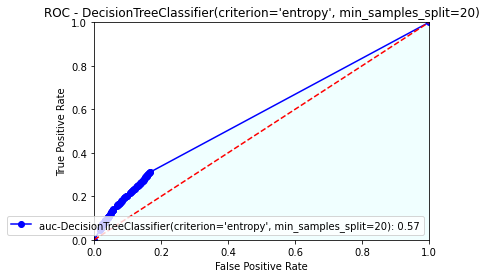

In [33]:
fpr_dtc,tpr_dct,thr_dct,auc_dct=roc_auc_func(Xts,yts,dct)

## Random Forest Classifier

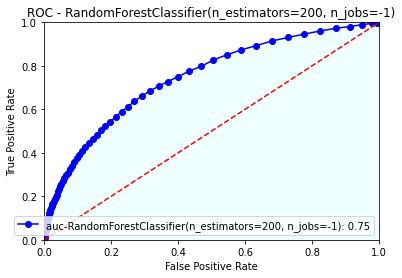

In [34]:
fpr_rfc,tpr_rfc,thr_rfc,auc_rfc=roc_auc_func(Xts,yts,rfc)

## ADA Boost

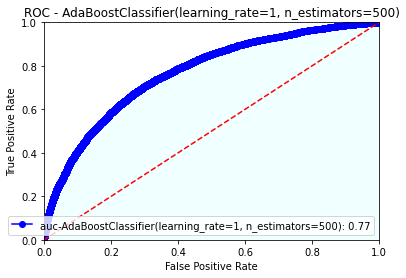

In [35]:
fpr_ada,tpr_ada,thr_ada,auc_ada=roc_auc_func(Xts,yts,ada)

## GRADIENT BOOST

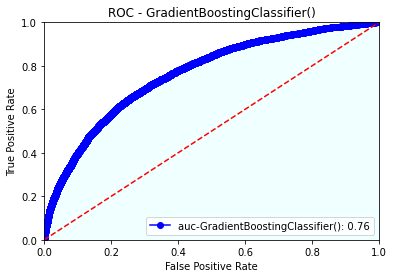

In [36]:
fpr_gb,tpr_gb,thr_gb,auc_gb=roc_auc_func(Xts,yts,gb)

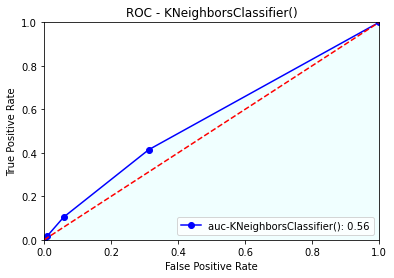

In [37]:
fpr_gb,tpr_gb,thr_gb,auc_gb=roc_auc_func(Xts,yts,knn)

# Model Comparation

In [38]:
def model_comparation(list_pred=list(),list_model=list()):
    list_model_rfc=list_pred
    array_model=[np.array(list_model)]
    fill_data={'accuracy score': [], 'precision (+) score': [],'recall (-) score':[],'f1 score':[],'True Positive':[],'True Negative':[], 'False Positive':[],'False Negative':[]}
    for i in list_model_rfc:
        t0,t1=confusion_matrix(i[0],i[1])
        fill_data['accuracy score'].append(accuracy_score(i[0],i[1]))
        fill_data['precision (+) score'].append(precision_score(i[0],i[1], pos_label=1))
        fill_data['recall (-) score'].append(recall_score(i[0],i[1],pos_label=0))
        fill_data['f1 score'].append(f1_score(i[0],i[1]))
        fill_data['True Positive'].append(t1[1])
        fill_data['True Negative'].append(t0[0])
        fill_data['False Positive'].append(t0[1])
        fill_data['False Negative'].append(t1[0])
    return pd.DataFrame(fill_data,index=array_model)

In [39]:
model_comparation([[yts,dct_pred],[yts,rfc_pred],[yts,ada_pred],[yts,gb_pred],[yts,knn_pred]],['Decision Trees','Random Forest','ADA Boost','Gradient Boost','KNN'])

,accuracy score,precision (+) score,recall (-) score,f1 score,True Positive,True Negative,False Positive,False Negative
Decision Trees,0.878821,0.172826,0.942392,0.154632,636,49796,3044,3910
Random Forest,0.920817,0.571429,0.999886,0.003509,8,52834,6,4538
ADA Boost,0.921113,0.531148,0.997294,0.066790,162,52697,143,4384
Gradient Boost,0.920939,0.525140,0.998391,0.039788,94,52755,85,4452
KNN,0.914178,0.141777,0.991408,0.029557,75,52386,454,4471


dari table ini dapat disimpulkan bahwa Random Forest Classifier dan Decision Trees merupakan model yang dapat menjawab apabila ada seseorang yang positif dalam sampel meskipun ada boost dan gradient boost memiliki recall (-) yang tinggi namun model tersebut tidak dapat mendeteksi kasus positif.

sehingga extra trees dan random Forest merupakan model yang akan dioptimisasi untuk kemudian dipilih yang terbaik namun keduanya akan di improve dan dipilih yang terbaik.

# Improve Model with over sampling

In [41]:
ros=RandomOverSampler()
smo=SMOTE()
rus=RandomUnderSampler()
Xros,yros=ros.fit_resample(Xtr,ytr)
Xsmo,ysmo=smo.fit_resample(Xtr,ytr)
Xrus,yrus=rus.fit_resample(Xtr,ytr)

## Decision Trees

In [42]:
dct_ros=DecisionTreeClassifier(criterion='entropy',min_samples_split=20)
dct_smo=DecisionTreeClassifier(criterion='entropy',min_samples_split=20)
dct_rus=DecisionTreeClassifier(criterion='entropy',min_samples_split=20)
dct_ros.fit(Xros,yros)
dct_smo.fit(Xsmo,ysmo)
dct_rus.fit(Xrus,yrus)

DecisionTreeClassifier(criterion='entropy', min_samples_split=20)

In [43]:
dct_pred_ros=dct_ros.predict(Xts)
dct_prob_ros=dct_ros.predict_proba(Xts)
dct_pred_smo=dct_smo.predict(Xts)
dct_prob_smo=dct_smo.predict_proba(Xts)
dct_pred_rus=dct_rus.predict(Xts)
dct_prob_rus=dct_rus.predict_proba(Xts)

In [44]:
display(confusion_matrix(yts,dct_pred_ros))
display(confusion_matrix(yts,dct_pred_smo))
display(confusion_matrix(yts,dct_pred_rus))

array([[48314,  4526],
       [ 3794,   752]], dtype=int64)

array([[49401,  3439],
       [ 3948,   598]], dtype=int64)

array([[32010, 20830],
       [ 1920,  2626]], dtype=int64)

In [45]:
print(classification_report(yts,dct_pred_ros))
print(classification_report(yts,dct_pred_smo))
print(classification_report(yts,dct_pred_rus))


              precision    recall  f1-score   support

           0       0.93      0.91      0.92     52840
           1       0.14      0.17      0.15      4546

    accuracy                           0.86     57386
   macro avg       0.53      0.54      0.54     57386
weighted avg       0.87      0.86      0.86     57386

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     52840
           1       0.15      0.13      0.14      4546

    accuracy                           0.87     57386
   macro avg       0.54      0.53      0.53     57386
weighted avg       0.86      0.87      0.87     57386

              precision    recall  f1-score   support

           0       0.94      0.61      0.74     52840
           1       0.11      0.58      0.19      4546

    accuracy                           0.60     57386
   macro avg       0.53      0.59      0.46     57386
weighted avg       0.88      0.60      0.69     57386



## Random Forest

In [46]:
rfc_ros=RandomForestClassifier(n_estimators=200,n_jobs=-1)
rfc_smo=RandomForestClassifier(n_estimators=200,n_jobs=-1)
rfc_rus=RandomForestClassifier(n_estimators=200,n_jobs=-1)
rfc_ros.fit(Xros,yros)
rfc_smo.fit(Xsmo,ysmo)
rfc_rus.fit(Xrus,yrus)

RandomForestClassifier(n_estimators=200, n_jobs=-1)

In [47]:
rfc_pred_ros=rfc_ros.predict(Xts)
rfc_prob_ros=rfc_ros.predict_proba(Xts)
rfc_pred_smo=rfc_smo.predict(Xts)
rfc_prob_smo=rfc_smo.predict_proba(Xts)
rfc_pred_rus=rfc_rus.predict(Xts)
rfc_prob_rus=rfc_rus.predict_proba(Xts)

In [48]:
display(confusion_matrix(yts,rfc_pred_ros))
display(confusion_matrix(yts,rfc_pred_smo))
display(confusion_matrix(yts,rfc_pred_rus))

array([[52772,    68],
       [ 4493,    53]], dtype=int64)

array([[52839,     1],
       [ 4543,     3]], dtype=int64)

array([[37196, 15644],
       [ 1458,  3088]], dtype=int64)

In [49]:
print(classification_report(yts,rfc_pred_ros))
print(classification_report(yts,rfc_pred_smo))
print(classification_report(yts,rfc_pred_rus))

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     52840
           1       0.44      0.01      0.02      4546

    accuracy                           0.92     57386
   macro avg       0.68      0.51      0.49     57386
weighted avg       0.88      0.92      0.88     57386

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     52840
           1       0.75      0.00      0.00      4546

    accuracy                           0.92     57386
   macro avg       0.84      0.50      0.48     57386
weighted avg       0.91      0.92      0.88     57386

              precision    recall  f1-score   support

           0       0.96      0.70      0.81     52840
           1       0.16      0.68      0.27      4546

    accuracy                           0.70     57386
   macro avg       0.56      0.69      0.54     57386
weighted avg       0.90      0.70      0.77     57386



## ADA Boost

In [50]:
ada_ros=AdaBoostClassifier()
ada_smo=AdaBoostClassifier()
ada_rus=AdaBoostClassifier()
ada_ros.fit(Xros,yros)
ada_smo.fit(Xsmo,ysmo)
ada_rus.fit(Xrus,yrus)

AdaBoostClassifier()

In [51]:
ada_ros_pred=ada_ros.predict(Xts)
ada_ros_prob=ada_ros.predict_proba(Xts)
ada_smo_pred=ada_smo.predict(Xts)
ada_smo_prob=ada_smo.predict_proba(Xts)
ada_rus_pred=ada_rus.predict(Xts)
ada_rus_prob=ada_rus.predict_proba(Xts)

In [52]:
display(confusion_matrix(yts,ada_ros_pred))
display(confusion_matrix(yts,ada_smo_pred))
display(confusion_matrix(yts,ada_rus_pred))

array([[37396, 15444],
       [ 1486,  3060]], dtype=int64)

array([[51580,  1260],
       [ 4135,   411]], dtype=int64)

array([[37221, 15619],
       [ 1486,  3060]], dtype=int64)

In [53]:
print(classification_report(yts,ada_ros_pred))
print(classification_report(yts,ada_smo_pred))
print(classification_report(yts,ada_rus_pred))

              precision    recall  f1-score   support

           0       0.96      0.71      0.82     52840
           1       0.17      0.67      0.27      4546

    accuracy                           0.70     57386
   macro avg       0.56      0.69      0.54     57386
weighted avg       0.90      0.70      0.77     57386

              precision    recall  f1-score   support

           0       0.93      0.98      0.95     52840
           1       0.25      0.09      0.13      4546

    accuracy                           0.91     57386
   macro avg       0.59      0.53      0.54     57386
weighted avg       0.87      0.91      0.89     57386

              precision    recall  f1-score   support

           0       0.96      0.70      0.81     52840
           1       0.16      0.67      0.26      4546

    accuracy                           0.70     57386
   macro avg       0.56      0.69      0.54     57386
weighted avg       0.90      0.70      0.77     57386



## Gradient Boost

In [54]:
gb_ros=GradientBoostingClassifier()
gb_smo=GradientBoostingClassifier()
gb_rus=GradientBoostingClassifier()
gb_ros.fit(Xros,yros)
gb_smo.fit(Xsmo,ysmo)
gb_rus.fit(Xrus,yrus)

GradientBoostingClassifier()

In [55]:
gb_ros_pred=gb_ros.predict(Xts)
gb_ros_prob=gb_ros.predict_proba(Xts)
gb_smo_pred=gb_smo.predict(Xts)
gb_smo_prob=gb_smo.predict_proba(Xts)
gb_rus_pred=gb_rus.predict(Xts)
gb_rus_prob=gb_rus.predict_proba(Xts)

In [56]:
display(confusion_matrix(yts,gb_ros_pred))
display(confusion_matrix(yts,gb_smo_pred))
display(confusion_matrix(yts,gb_rus_pred))

array([[37510, 15330],
       [ 1436,  3110]], dtype=int64)

array([[52749,    91],
       [ 4507,    39]], dtype=int64)

array([[37391, 15449],
       [ 1463,  3083]], dtype=int64)

In [57]:
print(classification_report(yts,gb_ros_pred))
print(classification_report(yts,gb_smo_pred))
print(classification_report(yts,gb_rus_pred))

              precision    recall  f1-score   support

           0       0.96      0.71      0.82     52840
           1       0.17      0.68      0.27      4546

    accuracy                           0.71     57386
   macro avg       0.57      0.70      0.54     57386
weighted avg       0.90      0.71      0.77     57386

              precision    recall  f1-score   support

           0       0.92      1.00      0.96     52840
           1       0.30      0.01      0.02      4546

    accuracy                           0.92     57386
   macro avg       0.61      0.50      0.49     57386
weighted avg       0.87      0.92      0.88     57386

              precision    recall  f1-score   support

           0       0.96      0.71      0.82     52840
           1       0.17      0.68      0.27      4546

    accuracy                           0.71     57386
   macro avg       0.56      0.69      0.54     57386
weighted avg       0.90      0.71      0.77     57386



## KNN

In [58]:
knn_ros=KNeighborsClassifier()
knn_ros.fit(Xros,yros)

KNeighborsClassifier()

In [59]:
knn_ros_pred=knn_ros.predict(Xts)
knn_ros_prob=knn_ros.predict_proba(Xts)

In [60]:
confusion_matrix(yts,knn_ros_pred)

array([[41896, 10944],
       [ 3278,  1268]], dtype=int64)

In [61]:
print(classification_report(yts,knn_ros_pred))

              precision    recall  f1-score   support

           0       0.93      0.79      0.85     52840
           1       0.10      0.28      0.15      4546

    accuracy                           0.75     57386
   macro avg       0.52      0.54      0.50     57386
weighted avg       0.86      0.75      0.80     57386



## Evaluasi

In [62]:
pd.set_option('display.max_rows',20)

In [63]:
model_comparation(
    [[yts,dct_pred_ros],[yts,dct_pred_smo],[yts,dct_pred_rus],
    [yts,dct_pred],
    [yts,rfc_pred_ros],[yts,rfc_pred_smo],[yts,rfc_pred_rus],
    [yts,rfc_pred],
    [yts,ada_ros_pred],[yts,ada_smo_pred],[yts,ada_rus_pred],
    [yts,ada_pred],
    [yts,gb_ros_pred],[yts,gb_smo_pred],[yts,gb_rus_pred],
    [yts,gb_pred]],
    ['Decision Trees ROS','Decision Trees SMO','Decision Trees RUS',
    'Decision Trees',
    'Random Forest ROS','Random Forest SMO','Random Forest RUS',
    'Random Forest',
    'ADA ROS','ADA SMO','ADA RUS',
    'ADA',
    'Gradient Boost ROS','Gradient Boost SMO','Gradient Boost RUS','Gradient Boost'])

,accuracy score,precision (+) score,recall (-) score,f1 score,True Positive,True Negative,False Positive,False Negative
Decision Trees ROS,0.855017,0.142478,0.914345,0.153094,752,48314,4526,3794
Decision Trees SMO,0.871275,0.148130,0.934917,0.139345,598,49401,3439,3948
Decision Trees RUS,0.603562,0.111954,0.605791,0.187558,2626,32010,20830,1920
Decision Trees,0.879169,0.174482,0.942695,0.155832,640,49812,3028,3906
Random Forest ROS,0.920521,0.438017,0.998713,0.022713,53,52772,68,4493
Random Forest SMO,0.920817,0.750000,0.999981,0.001319,3,52839,1,4543
Random Forest RUS,0.701983,0.164852,0.703936,0.265315,3088,37196,15644,1458
Random Forest,0.920730,0.363636,0.999868,0.001756,4,52833,7,4542
ADA ROS,0.704980,0.165370,0.707721,0.265510,3060,37396,15444,1486
ADA SMO,0.905988,0.245961,0.976154,0.132218,411,51580,1260,4135


ROC AUC for Decision Trees Over Sampling


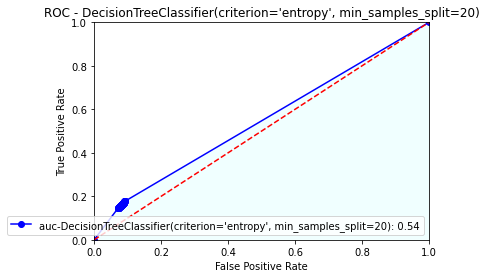

ROC AUC for Decision Trees SMOTE


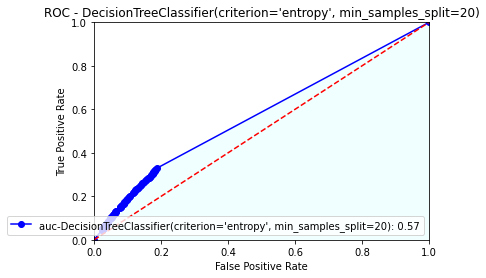

ROC AUC for Under Sampling


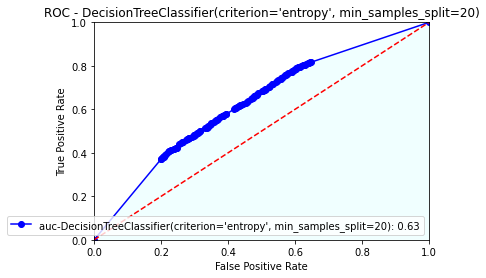

In [64]:
print('ROC AUC for Decision Trees Over Sampling')
fpr_dct_ros,tpr_dct_ros,thr_dct_ros,auc_dct_ros=roc_auc_func(Xts,yts,dct_ros)
print('ROC AUC for Decision Trees SMOTE')
fpr_dct_smo,tpr_dct_smo,thr_dct_smo,auc_dct_smo=roc_auc_func(Xts,yts,dct_smo)
print('ROC AUC for Under Sampling')
fpr_dct_rus,tpr_dct_rus,thr_dct_rus,auc_dct_rus=roc_auc_func(Xts,yts,dct_rus)

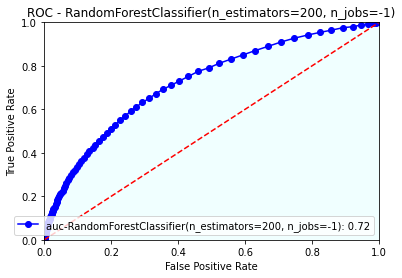

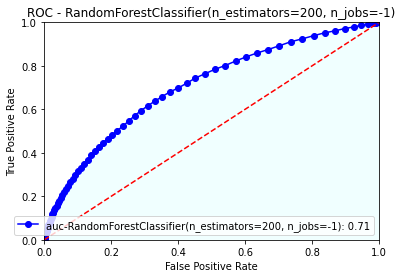

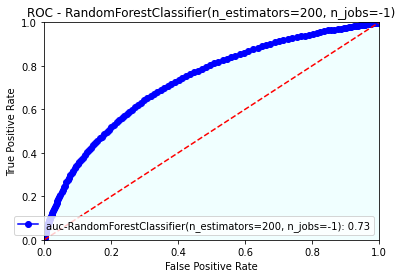

In [63]:
fpr_rfc_ros,tpr_rfc_ros,thr_rfc_ros,auc_rfc_ros=roc_auc_func(Xts,yts,rfc_ros)
fpr_rfc_smo,tpr_rfc_smo,thr_rfc_smo,auc_rfc_smo=roc_auc_func(Xts,yts,rfc_smo)
fpr_rfc_rus,tpr_rfc_rus,thr_rfc_rus,auc_rfc_rus=roc_auc_func(Xts,yts,rfc_rus)

ROC AUC for ADA Over Sampling


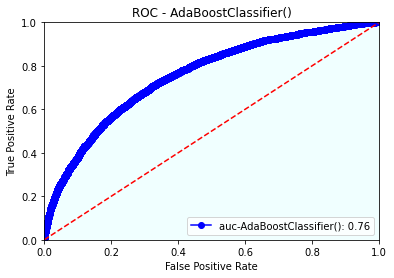

ROC AUC for ADA SMOTE


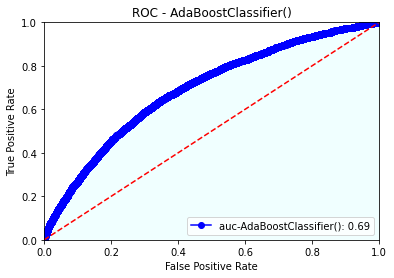

ROC AUC for ADA Under Sampling


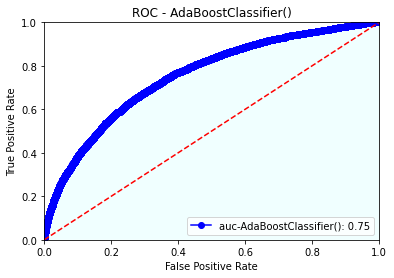

In [65]:
print('ROC AUC for ADA Over Sampling')
fpr_ada_ros,tpr_ada_ros,thr_ada_ros,auc_ada_ros=roc_auc_func(Xts,yts,ada_ros)
print('ROC AUC for ADA SMOTE')
fpr_ada_smo,tpr_ada_smo,thr_ada_smo,auc_ada_smo=roc_auc_func(Xts,yts,ada_smo)
print('ROC AUC for ADA Under Sampling')
fpr_ada_rus,tpr_ada_rus,thr_ada_rus,auc_ada_rus=roc_auc_func(Xts,yts,ada_rus)

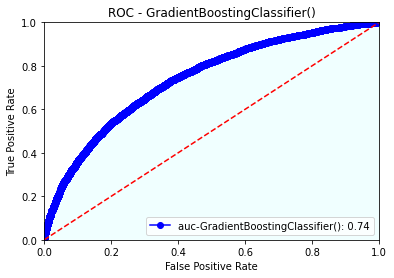

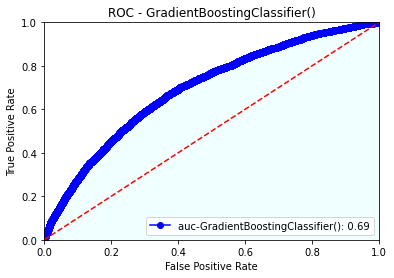

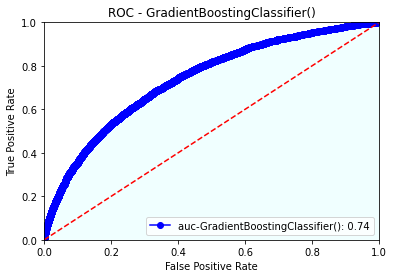

In [65]:
fpr_gb_ros,tpr_gb_ros,thr_gb_ros,auc_gb_ros=roc_auc_func(Xts,yts,gb_ros)
fpr_gb_smo,tpr_gb_smo,thr_gb_smo,auc_gb_smo=roc_auc_func(Xts,yts,gb_smo)
fpr_gb_rus,tpr_gb_rus,thr_gb_rus,auc_gb_rus=roc_auc_func(Xts,yts,gb_rus)

melihat evaluasi di atas ternyata didapati bahwa model ada mendapatkan hasil terbaik dengan nilai AUC 0.77

maka kita akan improve dengan menggeser threshold

In [66]:
def find_best_threshold(thr,pred_prob,y_true,best_fp, best_fn):
    best_threshold=[]
    for i in thr:
        pred_boost=[0 if x[1]<i else 1 for x in pred_prob]
        t0,t1=confusion_matrix(y_true,pred_boost)
        if t0[1]<best_fp and t1[0]<best_fn:
            best_threshold.append({i:[t0[1],t1[0]]})
    return best_threshold

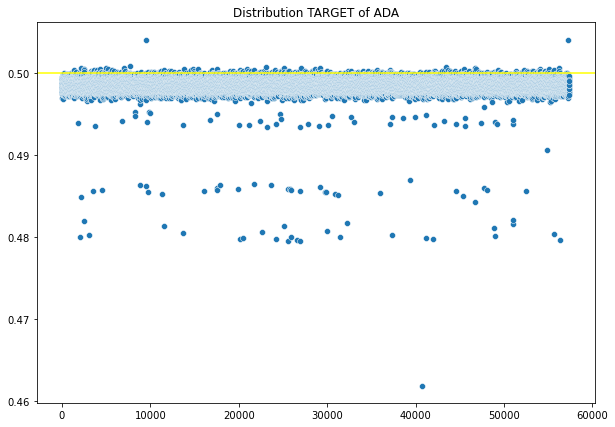

In [40]:
plt.figure(figsize=(10,7))
plt.title('Distribution TARGET of ADA')
sns.scatterplot(x=range(len(ada_prob[:,1])),y=ada_prob[:,1])
plt.axhline(0.5,color='yellow')

In [41]:
t0,t1=[],[]
for i in thr_ada:
    pred_boost=[0 if x[1]<i else 1 for x in ada_prob]
    t0a,t1a=confusion_matrix(yts,pred_boost)
    t0.append(t0a)
    t1.append(t1a)

In [42]:
t0a=[x[0] for x in t0]
t0b=[x[1] for x in t0]
t1a=[x[0] for x in t1]
t1b=[x[1] for x in t1]

In [43]:
best_thr=pd.DataFrame({'FPR' :fpr_ada, 'TPR':tpr_ada,'Treshold':thr_ada,'AUC Score':auc_ada,'TN':t0a,'FP':t0b,'FN':t1a,'TP':t1b,'xPoint':np.array(t0b)-np.array(t1b)})
best_thr

,FPR,TPR,Treshold,AUC Score,TN,FP,FN,TP,xPoint
0,0.000000,0.00000,1.504127,0.768904,52840,0,4546,0,0
1,0.000019,0.00000,0.504127,0.768904,52839,1,4546,0,1
2,0.000038,0.00000,0.504109,0.768904,52838,2,4546,0,2
3,0.000038,0.00044,0.500765,0.768904,52838,2,4544,2,0
4,0.000057,0.00044,0.500761,0.768904,52837,3,4544,2,1
...,...,...,...,...,...,...,...,...,...
7624,0.999565,0.99956,0.481985,0.768904,23,52817,2,4544,48273
7625,0.999565,0.99978,0.481739,0.768904,23,52817,1,4545,48272
7626,0.999697,0.99978,0.480468,0.768904,16,52824,1,4545,48279
7627,0.999697,1.00000,0.480437,0.768904,16,52824,0,4546,48278


In [44]:
best_thr.sort_values('xPoint')[:50]

,FPR,TPR,Treshold,AUC Score,TN,FP,FN,TP,xPoint
93,0.001419,0.025517,0.500084,0.768904,52765,75,4430,116,-41
95,0.001438,0.025737,0.500082,0.768904,52764,76,4429,117,-41
94,0.001438,0.025517,0.500083,0.768904,52764,76,4430,116,-40
99,0.001552,0.026397,0.500075,0.768904,52758,82,4426,120,-38
111,0.001722,0.028377,0.500057,0.768904,52749,91,4417,129,-38
97,0.001514,0.025957,0.500078,0.768904,52760,80,4428,118,-38
107,0.001665,0.027717,0.500064,0.768904,52752,88,4420,126,-38
87,0.001363,0.023977,0.500096,0.768904,52768,72,4437,109,-37
89,0.001382,0.024197,0.500090,0.768904,52767,73,4436,110,-37
91,0.001400,0.024417,0.500090,0.768904,52766,74,4435,111,-37


xPoint terendah merupakan threshold terbaik,

dari kasus ini dimana profit di dapatkan dari nasabah yang berhasil membayar secara penuh dan kerugian terjadi apabila seseorang tidak dapat membayar secara penuh atau charge off.
sehingga fp dibuat serendah mungkin dan TP dimaksimalkan sebesar mungkin, dan ditemukan titik temu dimana machine learning ini menyelamatkan perusahaan dengan 41 orang yang benar-benar bisa ditolak tanpa harus melakukan tindak lanjut.

kehilangan keuntungan dari 75 orang ditutupi oleh kehilangan kerugian yang akan disebabkan oleh 116 orang.
secara tidak langsung ini menyebabkan keuntungan sebanyak 41 orang.

# JOBLIB

setelah memeriksa Machine Learning yang sesuai dengan kasus. selanjutnya model tersebut disimpan menggunakan joblib sehingga dapat digunakan dalam flask web-app

In [45]:
import joblib

In [46]:
joblib.dump(ada, 'ada_model')

['ada_model']